In [38]:
import os, glob, csv, bz2, pickle

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import matplotlib as mpl


from itertools import combinations
import itertools

from time import time
from matplotlib import rc

from sklearn.metrics import confusion_matrix, jaccard_score, f1_score, accuracy_score, balanced_accuracy_score

plt.rcParams['axes.facecolor'] = 'silver'

In [39]:
# This is the path to data (stract inside Sim* files)
path_to_data   = r"/Users/Guille/Desktop/extreme_scenarios/data/"
path_to_data   = r"/Users/Guille/Dropbox/ProcessedDataTexas/vatic_output/Texas-7k/FunctionalDepthsTexas/"

path_to_images = r"/Users/Guille/Dropbox/ProcessedDataTexas/images/"

path_to_scen   = r'/Users/Guille/Desktop/extreme_scenarios/scenarios/clnSim/'
path_to_vatic  = r'/Users/Guille/Desktop/extreme_scenarios/outputs/Texas-7k/'

        
#metrics_ = ['Band Depth', 'Modified Band Depth', 'Directional Quantile', 'Extremal Depth', 'L$_\infty$ Depth', 
#            'Extreme Rank Length Depth', '$h$-Mode Depth', 'Random Tukey Depth', 'Integrated Depth', 'Random Projection Depth']

metrics_ = ['BD', 'MBD', 'DQ', 'ED', 'L$_\infty$D', 'ERLD', '$h$D', 'RTD', 'ID', 'RPD']

dates_ = ['2018-02-14', '2018-02-13', '2018-08-08', '2018-06-04', '2018-05-25',
          '2018-11-13', '2018-09-14', '2018-04-24', '2018-05-10', '2018-04-01',
          '2018-12-27', '2018-04-09', '2018-07-22', '2018-07-24', '2018-03-14',
          '2018-01-02', '2018-06-30', '2018-02-26', '2018-12-01', '2018-10-17',
          '2018-11-02', '2018-10-02', '2018-09-04', '2018-08-18', '2018-01-20']

features_ = ['Load [MWh]', 'Solar Generation [MWh]', 'Wind Generation [MWh]', 'VRE Generation [MWh]', 'Net Load [MWh]']
vatic_    = ['Variable Costs [k$]', 'Load Shedding [MWh]', 'VRE Curtailment [MWh]', 'Reserve Shortfall [MWh]']
zones_    = ['Coast', 'East', 'Far_West', 'North', 'North_Central', 'South', 'South_Central', 'West']

features_p_ = ['load', 'solar', 'wind', 'VRE', 'net']
vatic_p_    = ['costs', 'shedding', 'curtailment', 'shortfall']

In [40]:
with open(path_to_data + 'AreaZonalFuntionalDepths.pkl', 'rb') as handle:
    zonalFunAUC_ = pickle.load(handle)

with open(path_to_data + 'DiffZonalFuntionalDepths.pkl', 'rb') as handle:
    zonalFunDiff_ = pickle.load(handle)
print(zonalFunAUC_.shape, zonalFunDiff_.shape)

N_metrics, N_features, N_zones, N_days, N_scenarios = zonalFunAUC_.shape
print(N_metrics, N_features, N_zones, N_days, N_scenarios)

with open(path_to_data + 'AreaFuntionalDepths.pkl', 'rb') as handle:
    aggFunAUC_ = pickle.load(handle)

with open(path_to_data + 'DiffFuntionalDepths.pkl', 'rb') as handle:
    aggFunDiff_ = pickle.load(handle)
print(aggFunAUC_.shape, aggFunDiff_.shape)

N_metrics, N_features, N_days, N_scenarios = aggFunAUC_.shape
print(N_metrics, N_features, N_days, N_scenarios)

idx_plot_ = []
for i in range(2):
    for j in range(5):
        idx_plot_.append((i, j))

idx_dates_ = np.argsort(dates_)
dates_     = np.array(dates_)[idx_dates_]
print(dates_)

(10, 5, 8, 25, 1000) (10, 5, 8, 25, 1000)
10 5 8 25 1000
(10, 5, 25, 1000) (10, 5, 25, 1000)
10 5 25 1000
['2018-01-02' '2018-01-20' '2018-02-13' '2018-02-14' '2018-02-26'
 '2018-03-14' '2018-04-01' '2018-04-09' '2018-04-24' '2018-05-10'
 '2018-05-25' '2018-06-04' '2018-06-30' '2018-07-22' '2018-07-24'
 '2018-08-08' '2018-08-18' '2018-09-04' '2018-09-14' '2018-10-02'
 '2018-10-17' '2018-11-02' '2018-11-13' '2018-12-01' '2018-12-27']


In [41]:
with open(path_to_data + 'ProcessedZonalTexas.pkl', 'rb') as handle:
    zonalData_ = pickle.load(handle)   
        
with open(path_to_data + 'ProcessedAggregatedData.pkl', 'rb') as handle:
    aggData_ = pickle.load(handle)
    
print(zonalData_[0].shape, zonalData_[1].shape, zonalData_[2].shape, zonalData_[3].shape, zonalData_[4].shape)
print(aggData_[0].shape, aggData_[1].shape, aggData_[2].shape, aggData_[3].shape, aggData_[4].shape)

L_ = np.concatenate((np.swapaxes(aggData_[0], 0, 1)[..., np.newaxis, :], zonalData_[0]), axis = 2)
S_ = np.concatenate((np.swapaxes(aggData_[1], 0, 1)[..., np.newaxis, :], zonalData_[1]), axis = 2)
W_ = np.concatenate((np.swapaxes(aggData_[2], 0, 1)[..., np.newaxis, :], zonalData_[2]), axis = 2)
G_ = np.concatenate((np.swapaxes(aggData_[3], 0, 1)[..., np.newaxis, :], zonalData_[3]), axis = 2)
N_ = np.concatenate((np.swapaxes(aggData_[4], 0, 1)[..., np.newaxis, :], zonalData_[4]), axis = 2)
X_ = np.concatenate((L_[np.newaxis, ...], S_[np.newaxis, ...], W_[np.newaxis, ...], G_[np.newaxis, ...], N_[np.newaxis, ...]), axis = 0)
Y_ = zonalData_[5]
print(X_.shape, Y_.shape)

funAUC_  = np.swapaxes(np.swapaxes(np.concatenate((aggFunAUC_[:, :, np.newaxis, :, :], zonalFunAUC_), axis = 2), 2, 4), 3, 4)
funDiff_ = np.swapaxes(np.swapaxes(np.concatenate((aggFunDiff_[:, :, np.newaxis, :, :], zonalFunDiff_), axis = 2), 2, 4), 3, 4)
print(funAUC_.shape, funDiff_.shape, aggFunAUC_.shape, zonalFunAUC_.shape)

(24, 1000, 8, 25) (24, 1000, 8, 25) (24, 1000, 8, 25) (24, 1000, 8, 25) (24, 1000, 8, 25)
(1000, 24, 25) (1000, 24, 25) (1000, 24, 25) (1000, 24, 25) (1000, 24, 25)
(5, 24, 1000, 9, 25) (1000, 4, 25)
(10, 5, 1000, 9, 25) (10, 5, 1000, 9, 25) (10, 5, 25, 1000) (10, 5, 8, 25, 1000)


(1000,) (1000,)


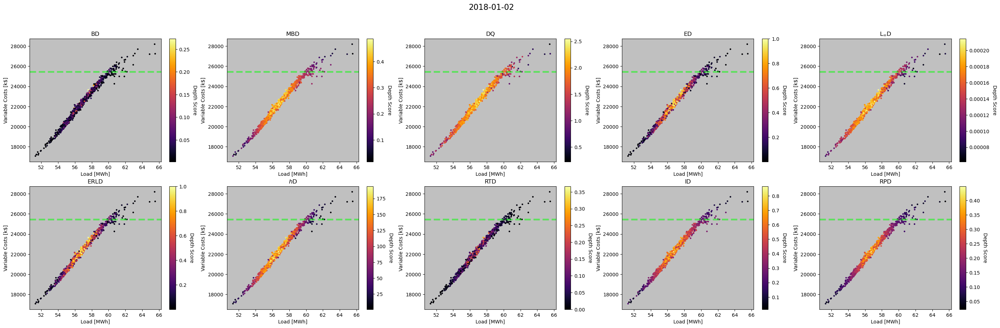

(1000,) (1000,)


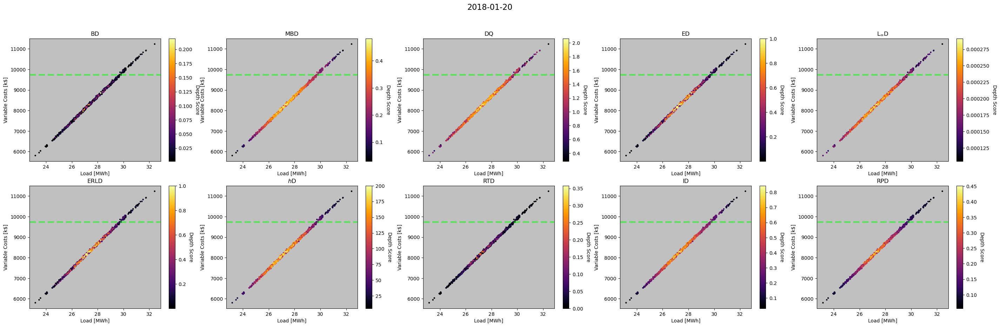

(1000,) (1000,)


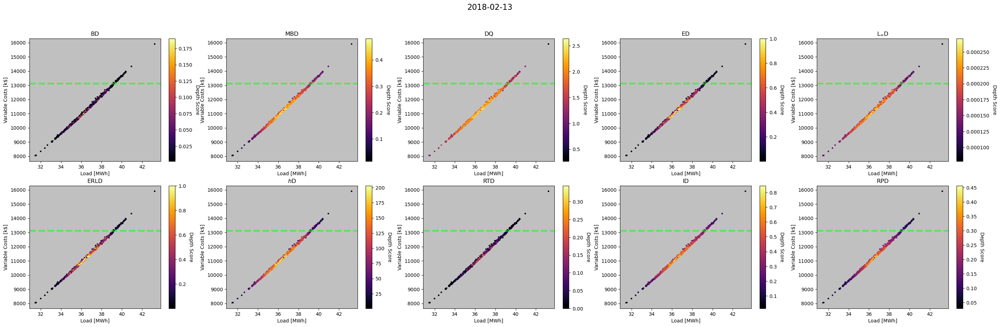

(1000,) (1000,)


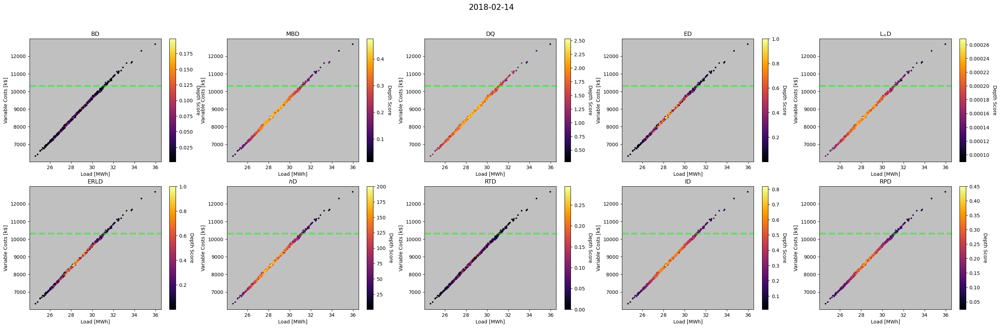

(1000,) (1000,)


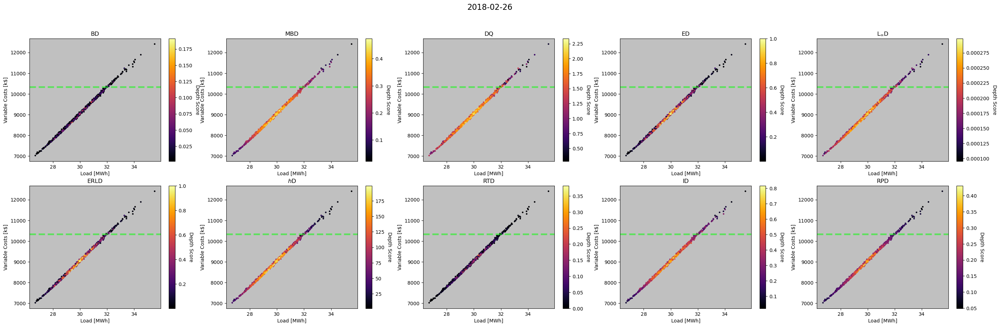

(1000,) (1000,)


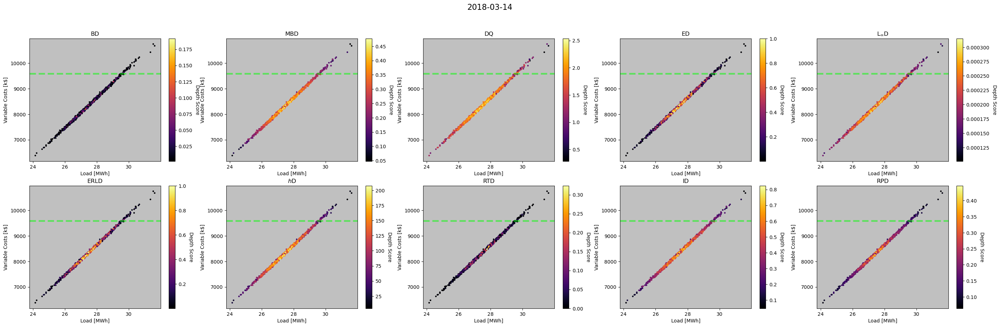

(1000,) (1000,)


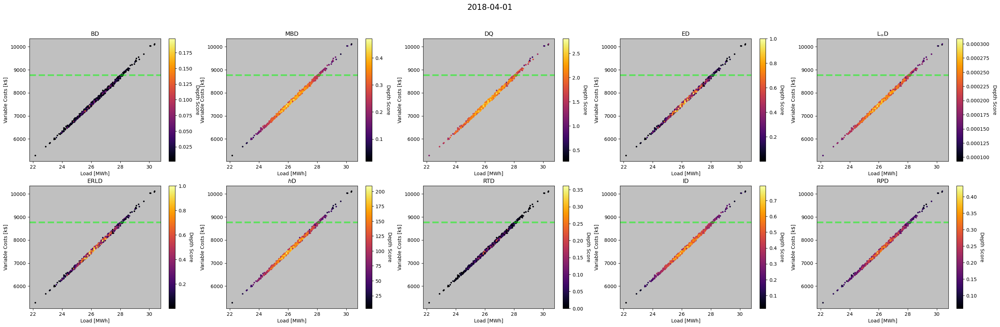

(1000,) (1000,)


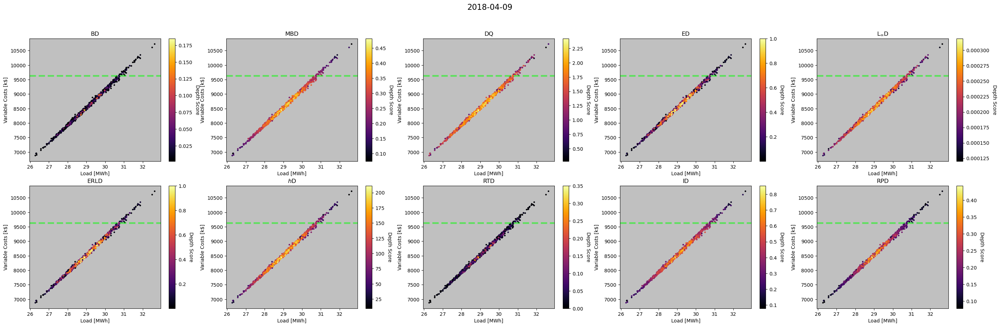

(1000,) (1000,)


KeyboardInterrupt: 

In [142]:
#for i_vatic in range(4):
#    for i_feature in [0, 3, 4]:
      
i_vatic = 0
i_feature = 4
for i_day in range(10):
    y_ = Y_[:, i_vatic, i_day]/1000
    x_ = np.mean(X_[i_feature, ..., 0, i_day], axis = 0)/1000
    print(x_.shape, y_.shape)

    idx_extreme_ = np.argsort(y_)
    idx_area_    = np.argsort(x_)

    y = y_[idx_extreme_][-50]
    x = x_[idx_area_][-50]

    plt.figure(figsize = (35, 10))
    plt.suptitle('{}'.format(dates_[i_day]), fontsize = 16)

    for i_metric in range(N_metrics):

        ax = plt.subplot2grid( (2, 5), idx_plot_[i_metric] )
#
        z_ = aggFunAUC_[i_metric, i_feature, i_day, :]
        #z_ = fdiff_[i_metric, i_feature, i_day, :]

        #z_ = 1. - z_/z_.sum()

        ax.set_title(metrics_[i_metric], fontsize = 12)


        ax.axhline(y, color     = 'lime', 
                       linestyle = '--', 
                       linewidth = 3.5, 
                       alpha     = 0.5)

        # ax.set_xticks([],[])
        # ax.set_yticks([],[])

        idx_ = np.argsort(z_)[::-1]
        #idx_ = _geater(X_[i_feature][..., i_day].T, idx_)

        #im = ax.scatter(np.arange(1000), z_[idx_], c = y_[idx_], s = 5., cmap = 'inferno')
        im = ax.scatter(x_, y_, c = z_, s = 5., cmap = 'inferno')

        ax.set_ylabel('{}'.format(vatic_[i_vatic]))
        ax.set_xlabel('{}'.format(features_[i_vatic]))

        # add the bar
        cbar = plt.colorbar(im)
        cbar.ax.set_ylabel('Depth Score', rotation = 270, labelpad = 15)

    name = 'fdepth/{}_{}_vs_{}.png'.format(dates_[i_day], features_p_[i_feature], vatic_p_[i_vatic])
    #plt.savefig(path_to_images + name, dpi = 250, bbox_inches = 'tight')
    plt.show()

(1000,) (1000,)


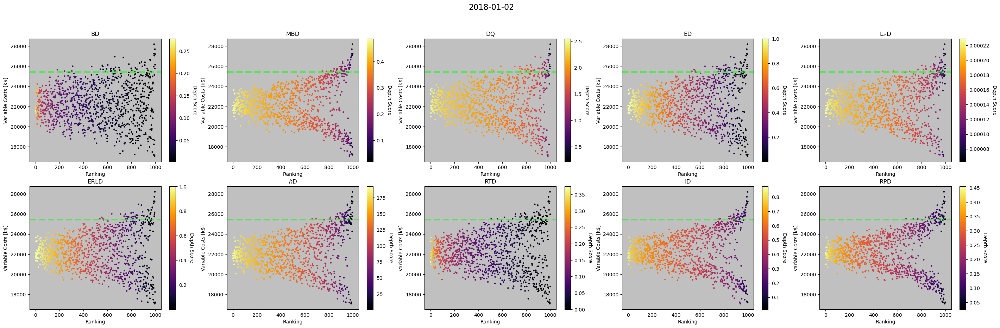

(1000,) (1000,)


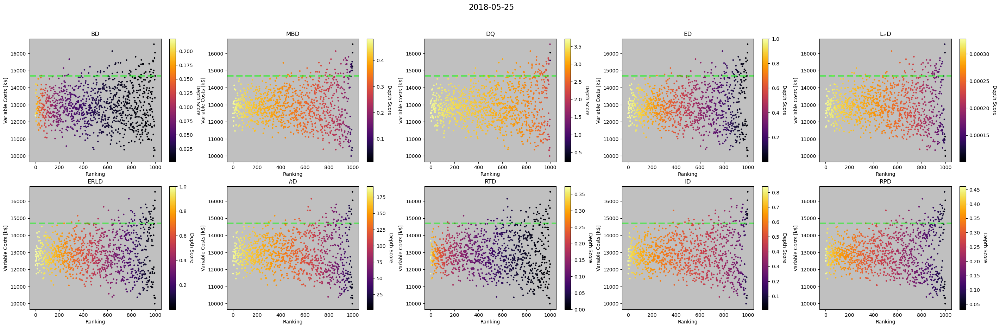

(1000,) (1000,)


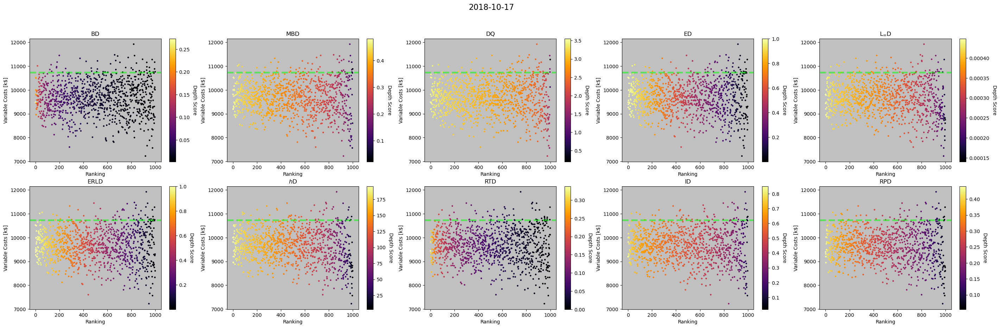

(1000,) (1000,)


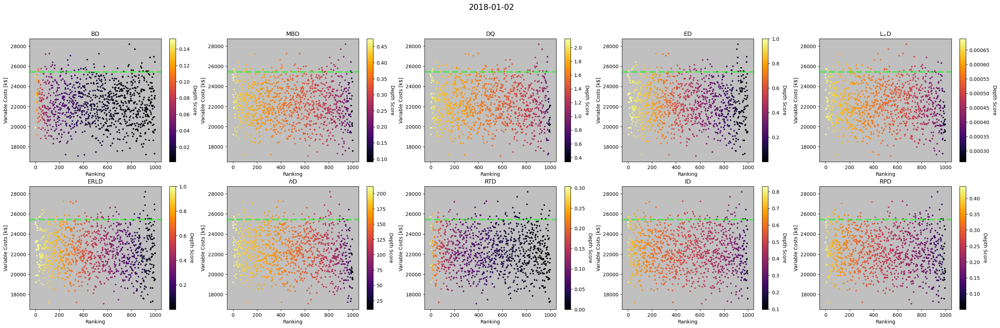

(1000,) (1000,)


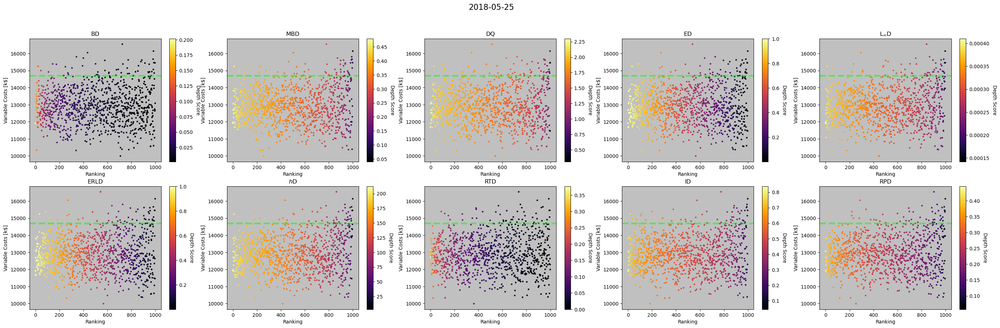

(1000,) (1000,)


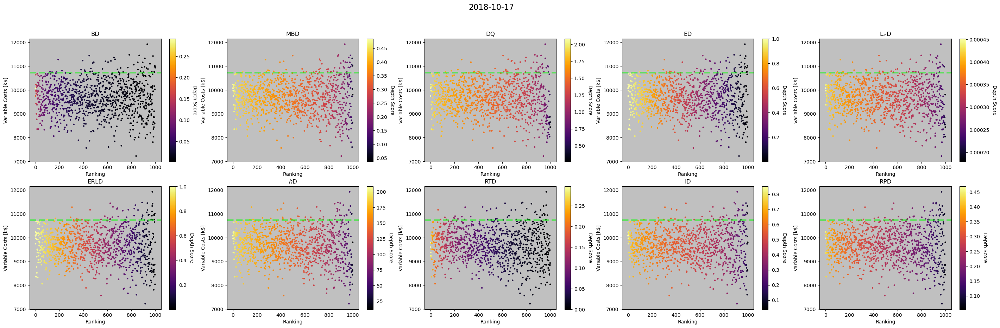

(1000,) (1000,)


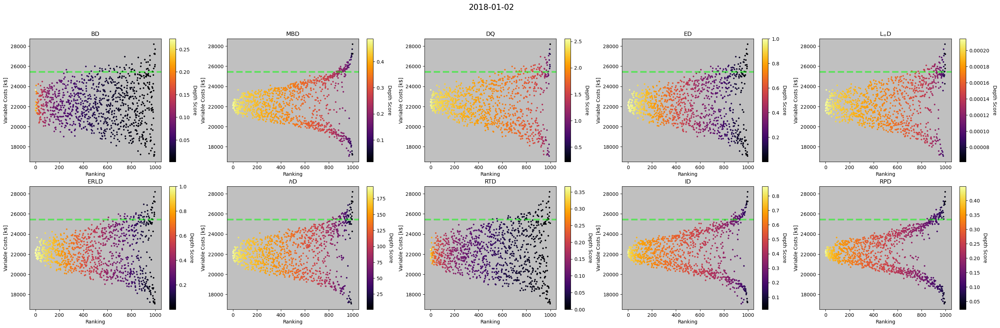

(1000,) (1000,)


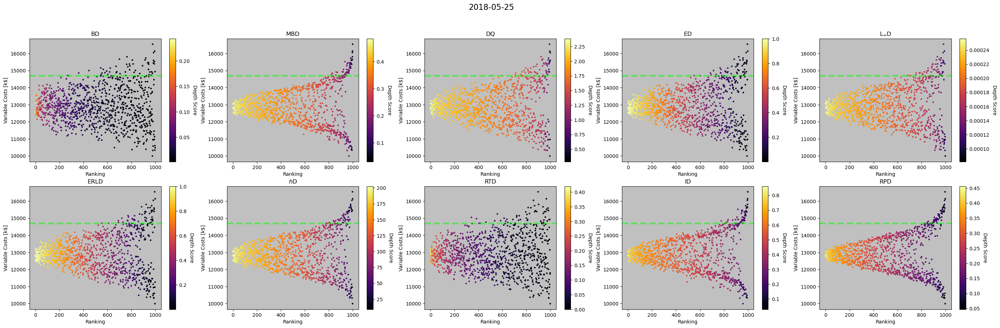

(1000,) (1000,)


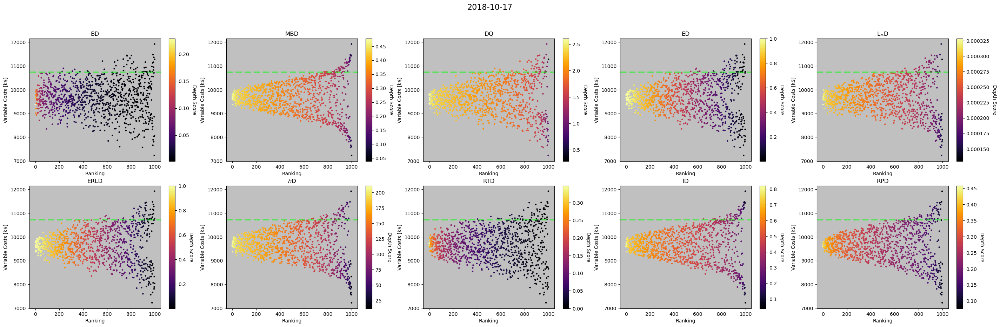

(1000,) (1000,)


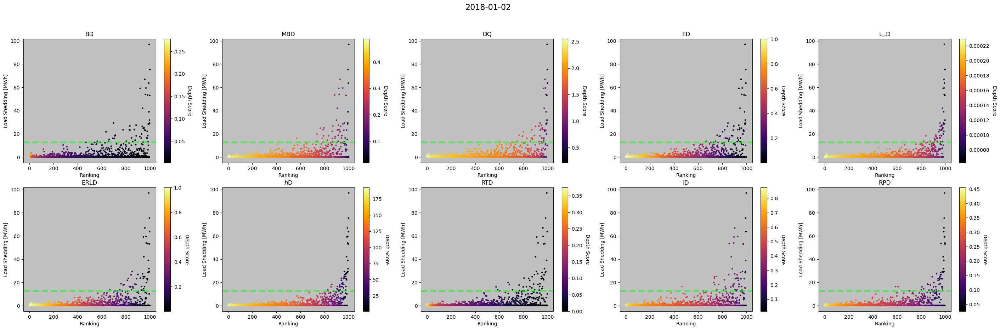

(1000,) (1000,)


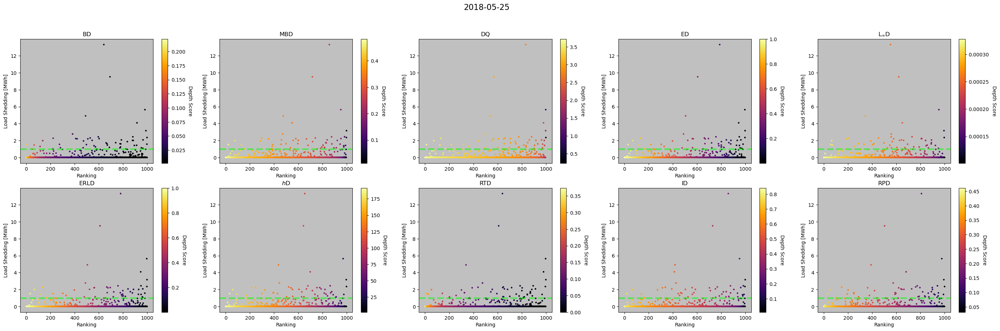

(1000,) (1000,)


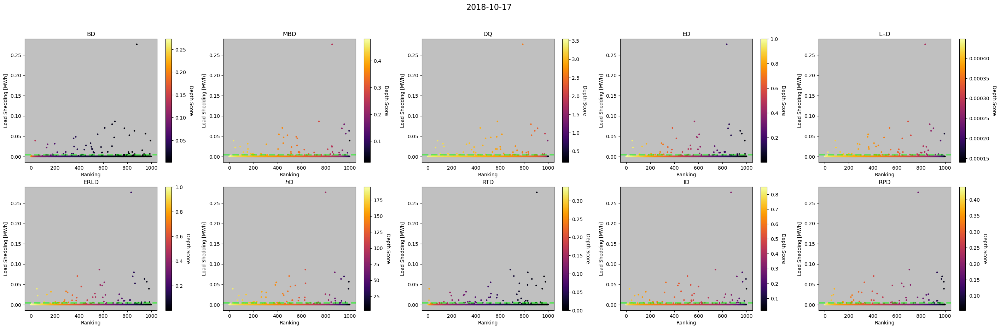

(1000,) (1000,)


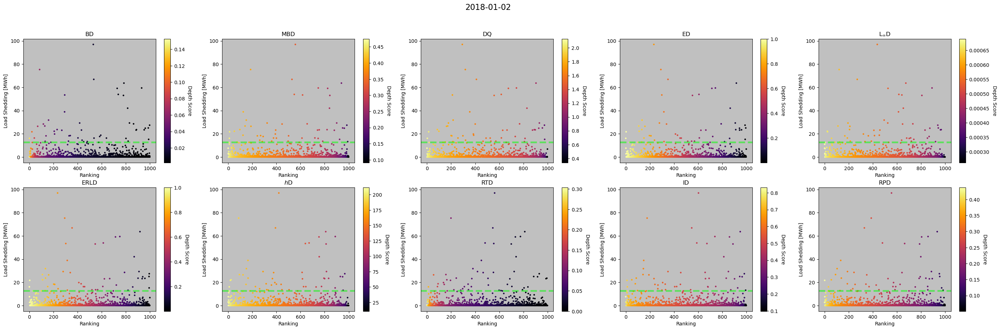

(1000,) (1000,)


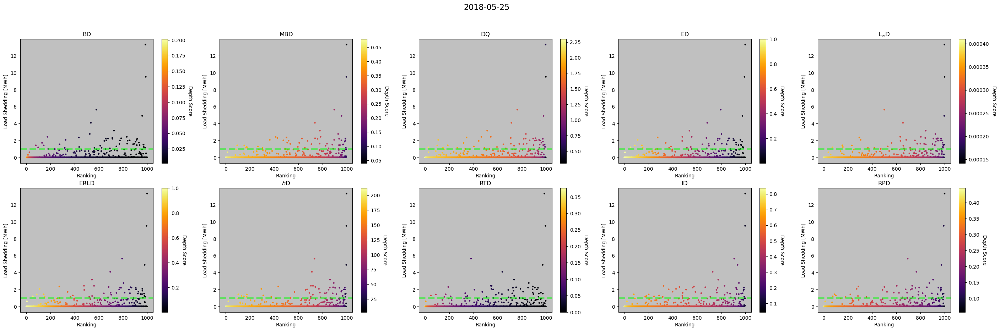

(1000,) (1000,)


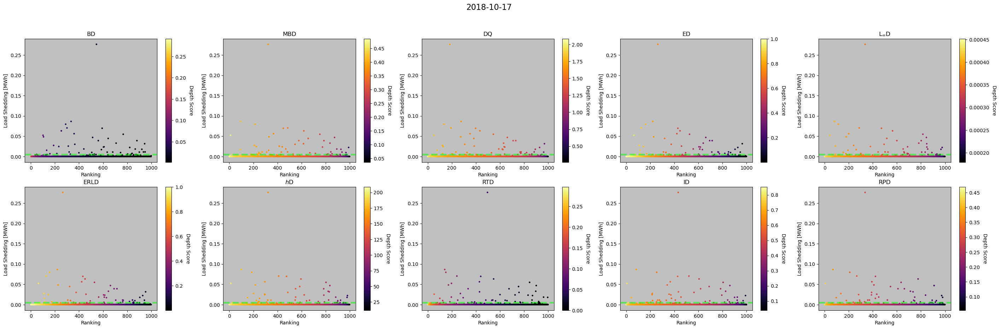

(1000,) (1000,)


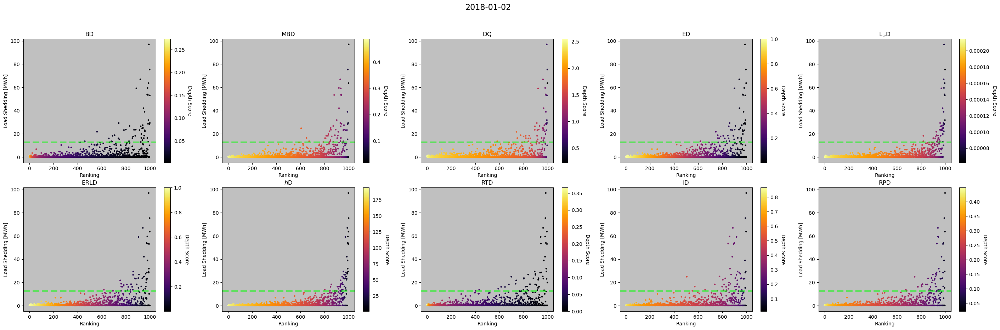

(1000,) (1000,)


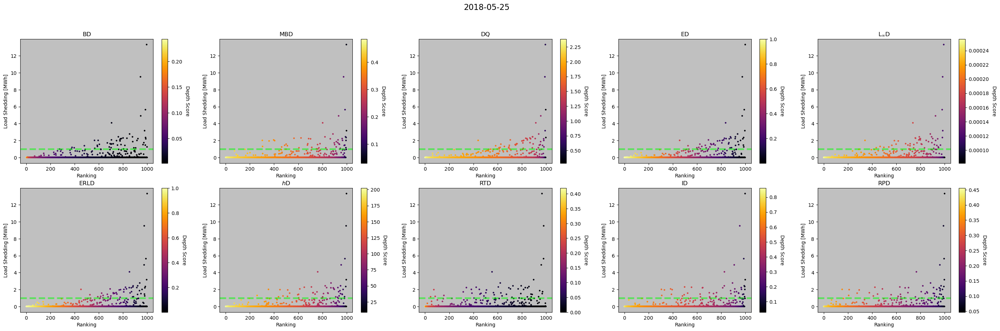

(1000,) (1000,)


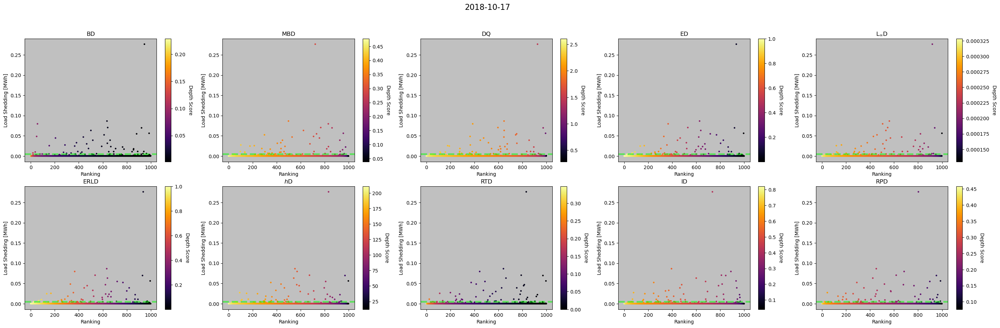

(1000,) (1000,)


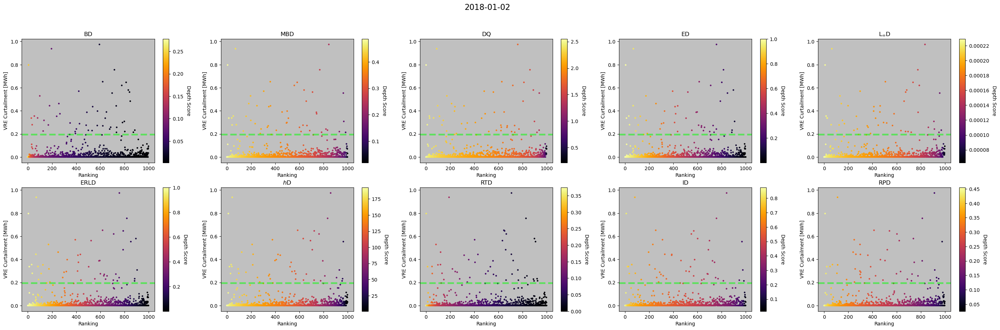

(1000,) (1000,)


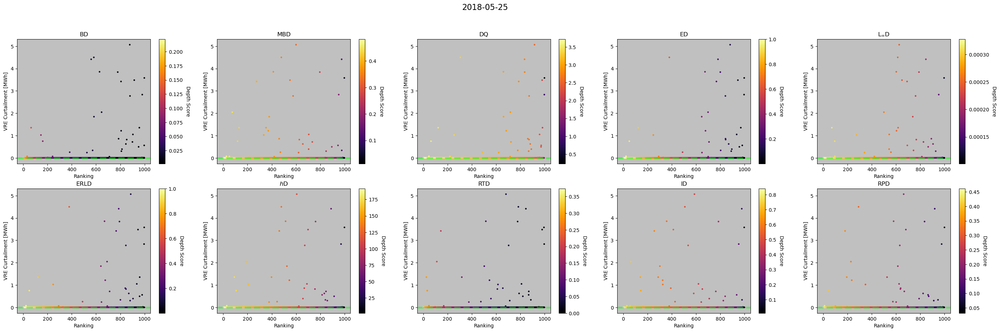

(1000,) (1000,)


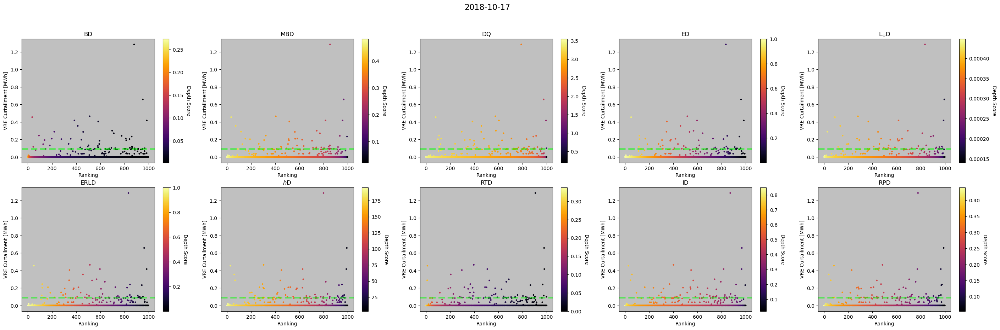

(1000,) (1000,)


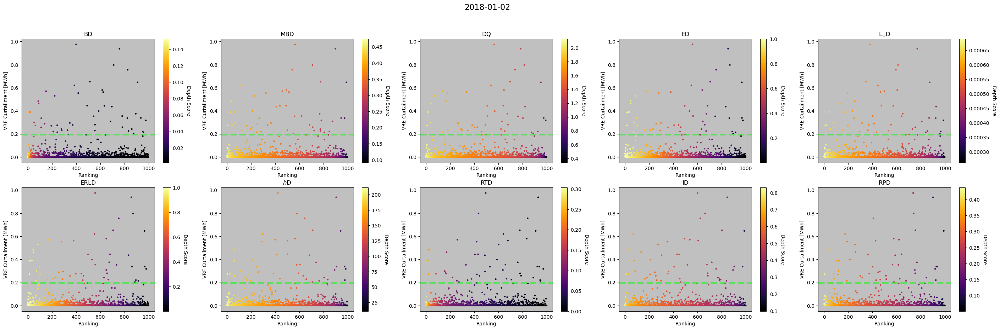

(1000,) (1000,)


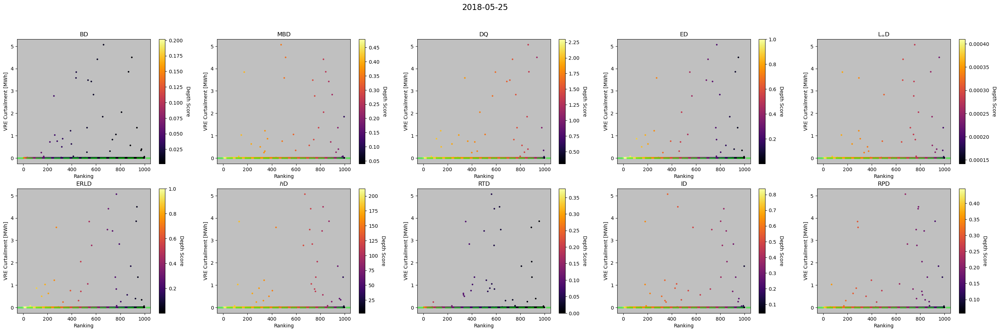

(1000,) (1000,)


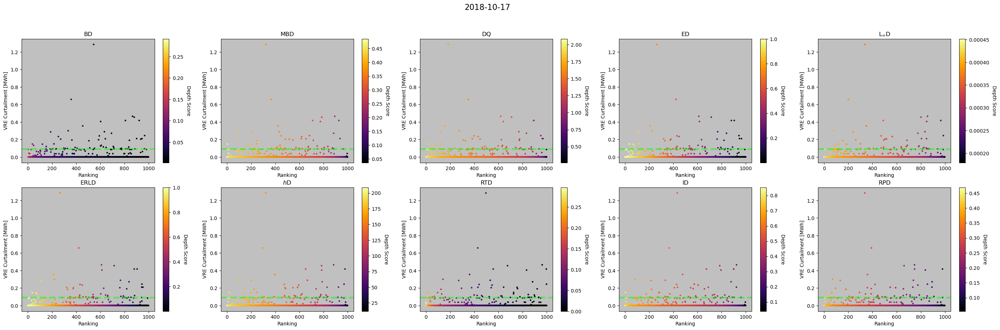

(1000,) (1000,)


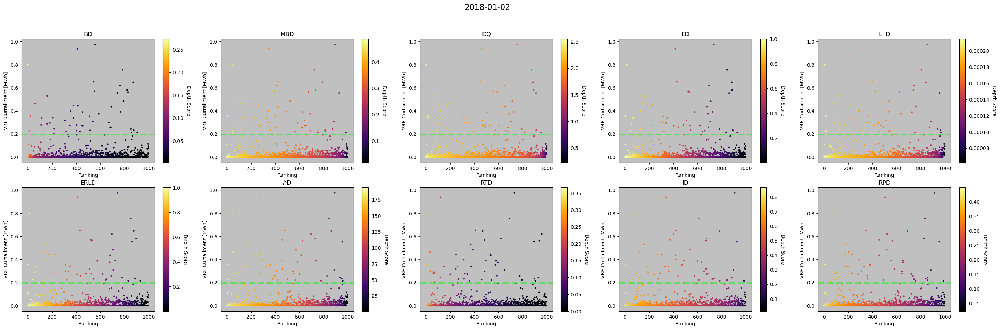

(1000,) (1000,)


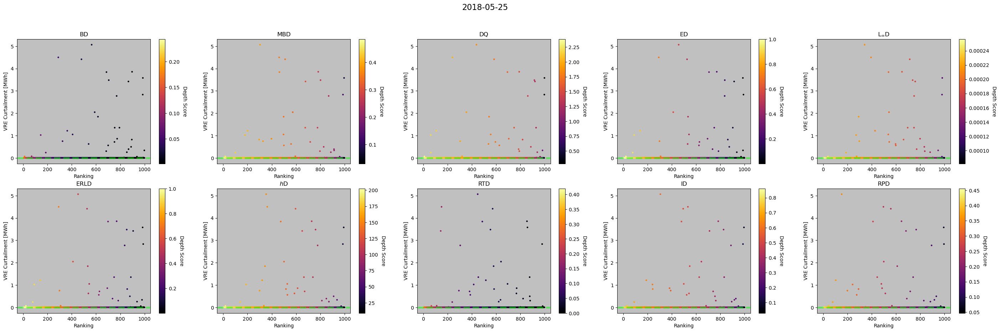

(1000,) (1000,)


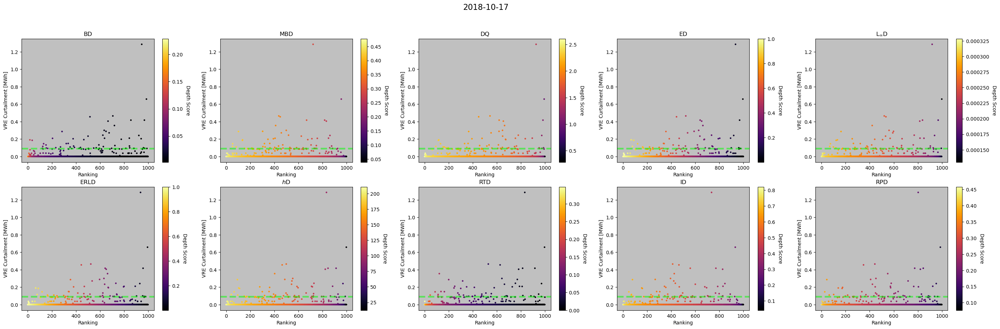

(1000,) (1000,)


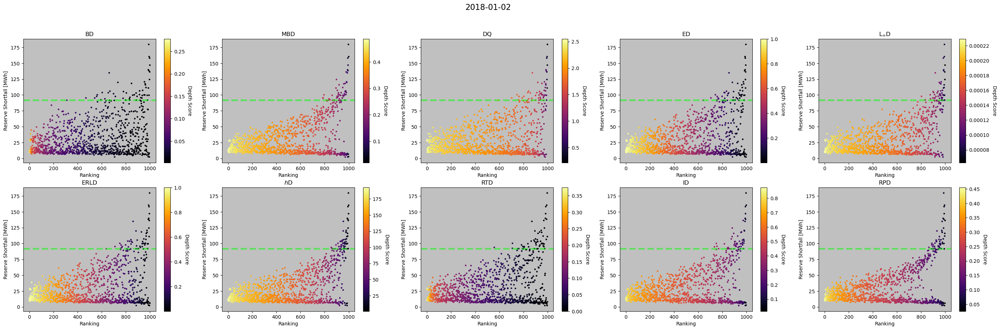

(1000,) (1000,)


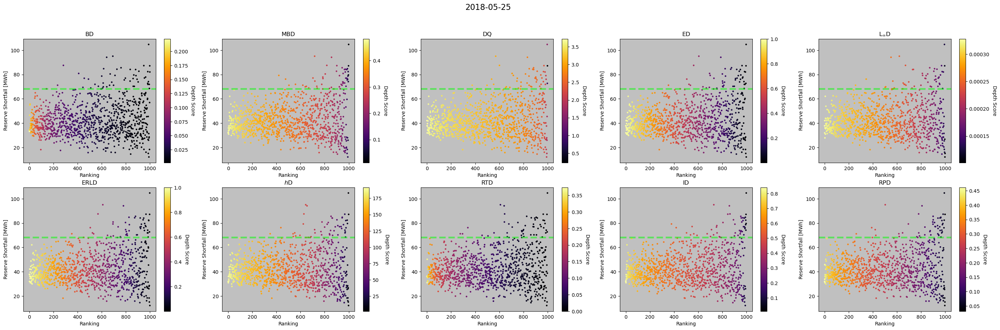

(1000,) (1000,)


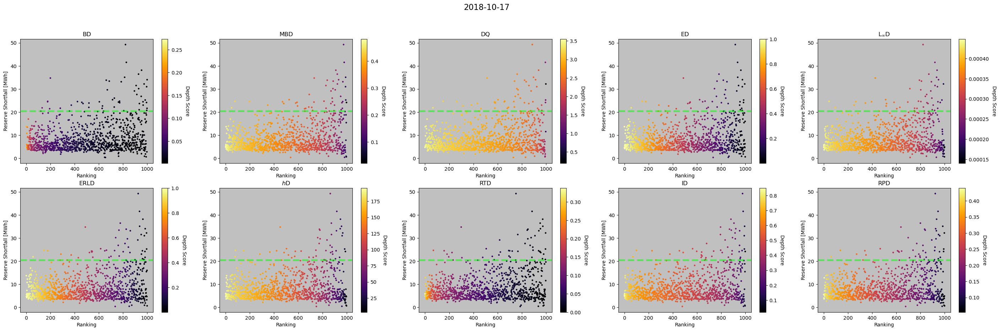

(1000,) (1000,)


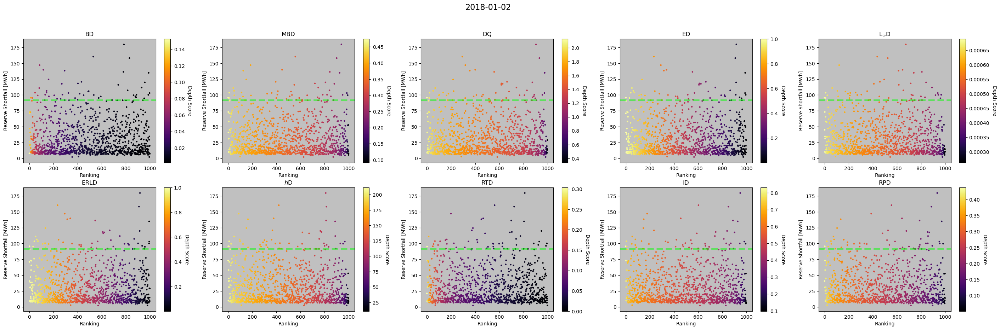

(1000,) (1000,)


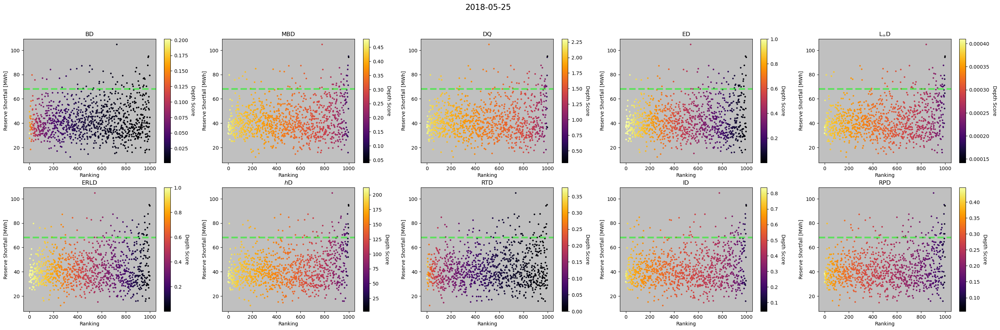

(1000,) (1000,)


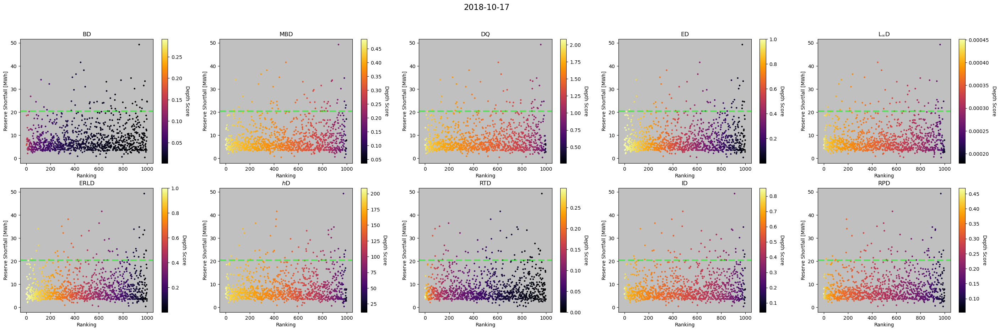

(1000,) (1000,)


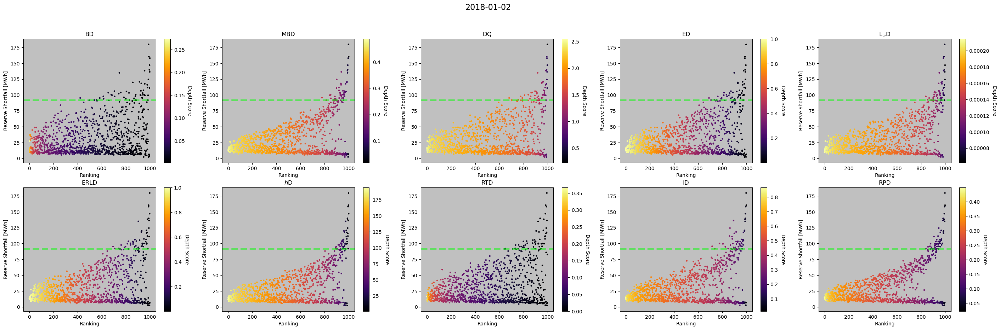

(1000,) (1000,)


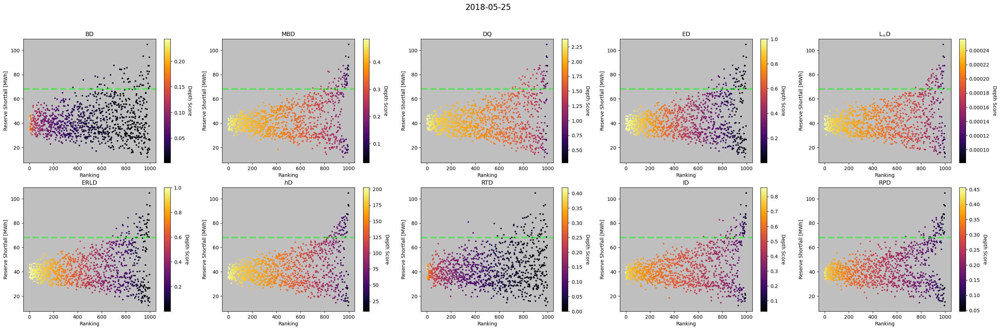

(1000,) (1000,)


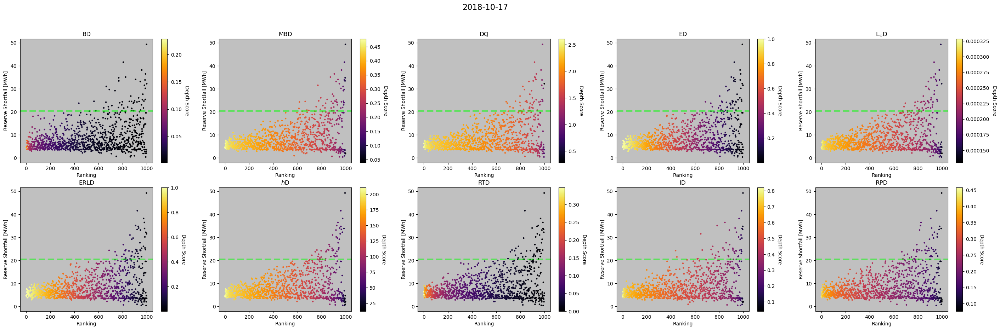

In [53]:
for i_vatic in range(4):
    for i_feature in [0, 3, 4]:
        for i_day in [0, 10, 20]:

            y_ = Y_[:, i_vatic, i_day]/1000
            x_ = np.mean(X_[i_feature, ..., 0, i_day], axis = 0)/1000
            print(x_.shape, y_.shape)

            idx_extreme_ = np.argsort(y_)
            idx_area_    = np.argsort(x_)

            y = y_[idx_extreme_][-50]
            x = x_[idx_area_][-50]

            plt.figure(figsize = (35, 10))
            plt.suptitle('{}'.format(dates_[i_day]), fontsize = 16)

            for i_metric in range(N_metrics):

                ax = plt.subplot2grid((2, 5), idx_plot_[i_metric] )
        #
                z_ = aggFunAUC_[i_metric, i_feature, i_day, :]
                #z_ = fdiff_[i_metric, i_feature, i_day, :]

                #z_ = 1. - z_/z_.sum()

                ax.set_title(metrics_[i_metric], fontsize = 12)


                ax.axhline(y, color     = 'lime', 
                               linestyle = '--', 
                               linewidth = 3.5, 
                               alpha     = 0.5)

                idx_ = np.argsort(z_)[::-1]
                #idx_ = _geater(X_[i_feature][..., i_day].T, idx_)

                im = ax.scatter(np.arange(1000), y_[idx_], c = z_[idx_], s = 5., cmap = 'inferno')
                #im = ax.scatter(x_, y_, c = z_, s = 5., cmap = 'inferno')

                ax.set_ylabel('{}'.format(vatic_[i_vatic]))
                ax.set_xlabel('Ranking')

                # add the bar
                cbar = plt.colorbar(im)
                cbar.ax.set_ylabel('Depth Score', rotation = 270, labelpad = 15)

            name = 'fdepth/{}_rank_{}_vs_{}.png'.format(dates_[i_day], features_p_[i_feature], vatic_p_[i_vatic])
            plt.savefig(path_to_images + name, dpi = 250, bbox_inches = 'tight')
            plt.show()

In [159]:
def _aggregate_and_zonal_extremality_detection(funAUC_, X_, y_, params_, idx_sel_, top = False, N_extreme = 50):
    
    dx_features_, idx_zones_, N_samples_, N_auc_filter_, idx_directions_, N_sel = params_
    
    # Adaptative Selection
    N_sel    = N_sel + idx_sel_.sum()
    if N_sel > 1000: N_sel = 1000

        
    if top:
        # Get Extreme scenarios
        top_extreme_ = np.argsort(y_)[::-1]
        ttl_energy   = y_[top_extreme_[:N_extreme]].sum()/1000.
    else:
        N_extreme    = int(np.sum(y_ > 0.))
        #print(N_extremes, idx_sel_.sum())
        ttl_energy   = y_[y_ > 0].sum()/1000.
        # if N_sel < N_extreme: 
        #     N_extreme = N_sel

    idx_sel_ = []
    
    N_samples_ = np.array(N_samples_) + 1e-10
    N_samples_ = N_samples_/N_samples_.sum()
    N_samples_ = N_samples_*N_sel
    N_samples_ = np.around(N_samples_).astype(int).tolist()

    # Baseline
    for i_feature in range(len(idx_features_)):
        direction     = idx_directions_[idx_features_[i_feature]]
        zones_        = idx_zones_[idx_features_[i_feature]]
        N_sel_feature = N_samples_[idx_features_[i_feature]]
        N_auc_filter  = N_auc_filter_[idx_features_[i_feature]]
        #print(idx_features_[i_feature])
        
        x_ = np.sum(X_[idx_features_[i_feature], ...], axis = 0)
                
        auc_ranks_   = []
        depth_ranks_ = []
        for i_zone in range(len(zones_)):
            idx_auc_ = np.argsort(x_[..., zones_[i_zone]])[::direction][:N_auc_filter]
            z_ = funAUC_[idx_features_[i_feature], :, zones_[i_zone]]
            if direction == -1: z_ = z_.max() - z_
            vmin = z_.min()
            vmax = z_.max()
            idx_depth_ = np.argsort(z_[idx_auc_])[::direction]
            depth_ranks_.append(idx_auc_[idx_depth_])
        
        depth_ranks_ = np.stack(depth_ranks_)
        
        for i in range(N_sel_feature + 1):
            idx_depth_zone_ = np.unique(depth_ranks_[:, :i])
            if idx_depth_zone_.shape[0] == N_sel_feature:
                break
            if idx_depth_zone_.shape[0] > N_sel_feature:
                idx_depth_zone_ = idx_depth_zone_[:N_sel_feature]
                break
        idx_sel_.append(idx_depth_zone_)

    idx_sel_ = np.unique(np.concatenate(idx_sel_, axis = 0))
    if top:
        idx_sel_ = np.intersect1d(top_extreme_[:N_extreme], idx_sel_)
        
    # plt.figure()
    # plt.scatter(y_, x_[..., 0], c = 'k')
    # #plt.scatter(y_[idx_auc_], x_[idx_auc_, 0], c = z_[idx_auc_], vmin = vmin, vmax = vmax, cmap = 'Reds')
    # #plt.scatter(y_[top_extreme_[:N_extreme]], x_[top_extreme_[:N_extreme], 0], c = z_[top_extreme_[:N_extreme]], vmin = vmin, vmax = vmax, cmap = 'Greens')
    # #plt.scatter(y_[idx_sel_], x_[idx_sel_, 0], c = z_[idx_sel_], vmin = vmin, vmax = vmax, cmap = 'Blues')
    # plt.show()
    
    energy   = y_[idx_sel_].sum()/1000.
    frac     = energy/ttl_energy
    return frac, energy, ttl_energy, N_sel, N_extreme

def _get_summary(frac_fdepth_, energy_fdepth_, energy_, N_sel_, N_extremes_, dates_, freq = False):
    
    df_1 = np.concatenate([N_extremes_[:, np.newaxis], N_sel_[:, np.newaxis], energy_[:, np.newaxis], energy_fdepth_], axis = 1)
    df_2 = np.concatenate([N_extremes_[:, np.newaxis], N_sel_[:, np.newaxis], energy_[:, np.newaxis], frac_fdepth_], axis = 1)

    df_1 = np.nan_to_num(df_1)
    df_2 = np.nan_to_num(df_2)

    if not freq: df_ = np.concatenate([df_1, np.sum(df_1, axis = 0)[np.newaxis, :], np.mean(df_1, axis = 0)[np.newaxis, :]], axis = 0)   
    else:        df_ = np.concatenate([df_2, np.median(df_2, axis = 0)[np.newaxis, :], np.mean(df_2, axis = 0)[np.newaxis, :]], axis = 0)   

    df_ = pd.DataFrame(df_, columns = ['No. Extreme.', 'No. Sel.', 'Energy'] +  metrics_, index = dates_ + ['Total', 'Avg.'])

    df_ = np.round(df_, decimals = 2)
    display(df_)
    print(df_.to_latex())

In [309]:
i_vatic         = 0
N_sel           = 75
idx_features_   = [4]
idx_zones_      = [[0], [0, 3, 7, 8], [0, 5], [0], [0]]
N_samples_      = [0, 0, 0, 0, 100]
N_auc_filter_   = [500, 0, 0, 0, 80]
idx_directions_ = [-1, 1, 1, 1, -1]
    
params_ = [idx_features_, idx_zones_, N_samples_, N_auc_filter_, idx_directions_, N_sel]


frac_fdepth_   = np.zeros((N_days, N_metrics))
energy_fdepth_ = np.zeros((N_days, N_metrics))
energy_        = np.zeros((N_days))
N_sel_         = np.zeros((N_days))
N_extremes_    = np.zeros((N_days))
idx_sel_       = np.zeros((1000))

for i_day in range(N_days):
    for i_metrics in range(N_metrics):
        frac_fdepth_[i_day, i_metrics], energy_fdepth_[i_day, i_metrics], energy_[i_day], N_sel_[i_day], N_extremes_[i_day] = _aggregate_and_zonal_extremality_detection(funAUC_[i_metrics, ..., i_day], X_[..., i_day], 
                                                       Y_[:, i_vatic, i_day], params_, idx_sel_, top = True, N_extreme = 50)
    
print(np.sum(energy_), np.sum(energy_fdepth_, axis = 0).max(), np.sum(energy_fdepth_, axis = 0).max()/np.sum(energy_))
print(np.sum(N_extremes_), np.sum(N_sel_), np.sum(N_extremes_)/np.sum(N_sel_))
print(np.mean(energy_))

#_get_summary(100.*frac_fdepth_, energy_fdepth_, energy_, N_sel_, N_extremes_, dates_, freq = True)

17209209.4764725 17173988.8720609 0.9979533862691512
1250.0 1875.0 0.6666666666666666
688368.3790589


In [ ]:
i_vatic         = 1
N_sel           = 100
idx_features_   = [4, 3]
idx_zones_      = [[0], [0, 3, 7, 8], [0, 5], [0], [0, 5]]
N_samples_      = [0, 0, 0, 0, 42]
N_auc_filter_   = [0, 0, 0, 0, 650]
idx_directions_ = [-1, 1, 1, -1, -1]
    
params_ = [idx_features_, idx_zones_, N_samples_, N_auc_filter_, idx_directions_, N_sel]


frac_fdepth_   = np.zeros((N_days, N_metrics))
energy_fdepth_ = np.zeros((N_days, N_metrics))
energy_        = np.zeros((N_days))
N_sel_         = np.zeros((N_days))
N_extremes_    = np.zeros((N_days))

print(funAUC_.shape, X_.shape, Y_.shape)
i_metrics = 1
for i_day in range(N_days):
    idx_sel_ = np.sum(X_[4, ..., 0, i_day] > 62500., axis = 0) > 0.
    for i_metrics in range(N_metrics):
        frac_fdepth_[i_day, i_metrics], energy_fdepth_[i_day, i_metrics], energy_[i_day], N_sel_[i_day], N_extremes_[i_day] = _aggregate_and_zonal_extremality_detection(funAUC_[i_metrics, ..., i_day], X_[..., i_day], 
                                                                        Y_[:, i_vatic, i_day], params_, idx_sel_)

print(np.sum(energy_), np.sum(energy_fdepth_, axis = 0).max(), np.sum(energy_fdepth_, axis = 0).max()/np.sum(energy_))
print(np.sum(N_extremes_), np.sum(N_sel_), np.sum(N_extremes_)/np.sum(N_sel_))
print(np.mean(energy_))

#_get_summary(frac_fdepth_, energy_fdepth_, energy_, N_sel_, N_extremes_, dates_, freq = False)

(10, 5, 1000, 9, 25) (5, 24, 1000, 9, 25) (1000, 4, 25)
6126.093694099999 5675.453327799999 0.9264391978310732
3737.0 5639.0 0.6627061535733286
245.04374776399996


In [357]:
i_vatic         = 2
N_sel           = 30
idx_features_   = [0]
idx_zones_      = [[0, 3], [0], [0], [3], [0]]
N_samples_      = [70, 0, 0, 0, 0, 0]
N_auc_filter_   = [1000, 500, 1000, 500, 1000]
idx_directions_ = [-1, -1, -1, 1, -1]
    
params_ = [idx_features_, idx_zones_, N_samples_, N_auc_filter_, idx_directions_, N_sel]


frac_fdepth_   = np.zeros((N_days, N_metrics))
energy_fdepth_ = np.zeros((N_days, N_metrics))
energy_        = np.zeros((N_days))
N_sel_         = np.zeros((N_days))
N_extremes_    = np.zeros((N_days))
idx_sel_       = np.zeros((1000))

for i_day in range(N_days):
    #idx_sel_ = np.mean(X_[3, ..., 0, i_day], axis = 0) > 8700
    idx_sel_ = (np.mean(X_[3, ..., 0, i_day], axis = 0) > 8500)# | (np.mean(X_[0, ..., 0, i_day], axis = 0) < 33000)

    for i_metrics in range(N_metrics):
        
        frac_fdepth_[i_day, i_metrics], energy_fdepth_[i_day, i_metrics], energy_[i_day], N_sel_[i_day], N_extremes_[i_day] = _aggregate_and_zonal_extremality_detection(funAUC_[i_metrics, ..., i_day], X_[..., i_day], 
                                                                        Y_[:, i_vatic, i_day], params_, idx_sel_)

print(np.sum(energy_), np.sum(energy_fdepth_, axis = 0).max(), np.sum(energy_fdepth_, axis = 0).max()/np.sum(energy_))
print(np.sum(N_extremes_), np.sum(N_sel_), np.sum(N_extremes_)/np.sum(N_sel_))
print(np.mean(energy_))

#_get_summary(frac_fdepth_, energy_fdepth_, energy_, N_sel_, N_extremes_, dates_, freq = False)

/var/folders/0c/ffx2kgyn7xq4krqrpsv67l3m0000gn/T/ipykernel_8788/4094150917.py:72: RuntimeWarning: invalid value encountered in double_scalars
  frac     = energy/ttl_energy


2180.7717672 1537.5525854 0.7050497482247486
6037.0 9102.0 0.6632608217974072
87.230870688


In [313]:
i_vatic         = 3
N_sel           = 75
idx_features_   = [4]
idx_zones_      = [[0], [0, 3, 7, 8], [0, 5], [0], [0]]
N_samples_      = [0, 0, 0, 0, 100]
N_auc_filter_   = [500, 0, 0, 0, 150]
idx_directions_ = [-1, 1, 1, 1, -1]
    
params_ = [idx_features_, idx_zones_, N_samples_, N_auc_filter_, idx_directions_, N_sel]

frac_fdepth_   = np.zeros((N_days, N_metrics))
energy_fdepth_ = np.zeros((N_days, N_metrics))
energy_        = np.zeros((N_days))
N_sel_         = np.zeros((N_days))
N_extremes_    = np.zeros((N_days))
idx_sel_       = np.zeros((1000))

for i_day in range(N_days):
    for i_metrics in range(N_metrics):
        
        frac_fdepth_[i_day, i_metrics], energy_fdepth_[i_day, i_metrics], energy_[i_day], N_sel_[i_day], N_extremes_[i_day] = _aggregate_and_zonal_extremality_detection(funAUC_[i_metrics, ..., i_day], X_[..., i_day], 
                                                                            Y_[:, i_vatic, i_day], params_, idx_sel_, top = True, N_extreme = 50)

print(np.sum(energy_), np.sum(energy_fdepth_, axis = 0).max(), np.sum(energy_fdepth_, axis = 0).max()/np.sum(energy_))
print(np.sum(N_extremes_), np.sum(N_sel_), np.sum(N_extremes_)/np.sum(N_sel_))
print(np.mean(energy_))

#_get_summary(100.*frac_fdepth_, energy_fdepth_, energy_, N_sel_, N_extremes_, dates_, freq = True)

83785.5491861 77119.29015419999 0.9204366493189264
1250.0 1875.0 0.6666666666666666
3351.421967444


In [71]:
i_vatic         = 1
N_sel           = 200
idx_features_   = [4]
idx_zones_      = [[0], [0, 3, 7, 8], [0, 5], [0], [0]]
N_samples_      = [0, 0, 0, 0, 100]
N_auc_filter_   = [0, 0, 0, 600, 550]
idx_directions_ = [-1, 1, 1, -1, -1]
idx_sel_        = np.zeros((1000))

params_ = [idx_features_, idx_zones_, N_samples_, N_auc_filter_, idx_directions_, N_sel]


frac_fdepth_   = np.zeros((N_days, N_metrics))
energy_fdepth_ = np.zeros((N_days, N_metrics))
energy_        = np.zeros((N_days))
N_sel_         = np.zeros((N_days))
N_extremes_    = np.zeros((N_days))
idx_sel_       = np.zeros((1000))

for i_day in range(N_days):
    #idx_sel_ = np.sum(X_[4, ..., 0, i_day] > 63300., axis = 0) > 0.
    for i_metrics in range(N_metrics):
        frac_fdepth_[i_day, i_metrics], energy_fdepth_[i_day, i_metrics], energy_[i_day], N_sel_[i_day], N_extremes_[i_day] = _aggregate_and_zonal_extremality_detection(funAUC_[i_metrics, ..., i_day], X_[..., i_day], 
                                                                        Y_[:, i_vatic, i_day], params_, idx_sel_)

print(np.sum(energy_), np.sum(energy_fdepth_, axis = 0).max(), np.sum(energy_fdepth_, axis = 0).max()/np.sum(energy_))
print(np.sum(N_extremes_), np.sum(N_sel_), np.sum(N_extremes_)/np.sum(N_sel_))
print(np.mean(energy_))

#_get_summary(frac_fdepth_, energy_fdepth_, energy_, N_sel_, N_extremes_, dates_, freq = False)

6126.093694099999 4425.6663605 0.7224287745978046
3737.0 5000.0 0.7474
245.04374776399996


In [73]:
i_vatic         = 2
N_sel           = 322
idx_features_   = [0]
idx_zones_      = [[0], [0], [0], [0], [1]]
N_samples_      = [70, 0, 0, 0, 0, 0]
N_auc_filter_   = [1000, 500, 1000, 1000, 1000]
idx_directions_ = [-1, -1, -1, -1, -1]
    
params_ = [idx_features_, idx_zones_, N_samples_, N_auc_filter_, idx_directions_, N_sel]


frac_fdepth_   = np.zeros((N_days, N_metrics))
energy_fdepth_ = np.zeros((N_days, N_metrics))
energy_        = np.zeros((N_days))
N_sel_         = np.zeros((N_days))
N_extremes_    = np.zeros((N_days))
idx_sel_       = np.zeros((1000))

for i_day in range(N_days):
    #idx_sel_ = np.mean(X_[3, ..., 0, i_day], axis = 0) > 8700
    for i_metrics in range(N_metrics):
        frac_fdepth_[i_day, i_metrics], energy_fdepth_[i_day, i_metrics], energy_[i_day], N_sel_[i_day], N_extremes_[i_day] = _aggregate_and_zonal_extremality_detection(funAUC_[i_metrics, ..., i_day], X_[..., i_day], 
                                                                        Y_[:, i_vatic, i_day], params_, idx_sel_)

print(np.sum(energy_), np.sum(energy_fdepth_, axis = 0).max(), np.sum(energy_fdepth_, axis = 0).max()/np.sum(energy_))
print(np.sum(N_extremes_), np.sum(N_sel_), np.sum(N_extremes_)/np.sum(N_sel_))
print(np.mean(energy_))

#_get_summary(frac_fdepth_, energy_fdepth_, energy_, N_sel_, N_extremes_, dates_, freq = False)

/var/folders/0c/ffx2kgyn7xq4krqrpsv67l3m0000gn/T/ipykernel_8788/95707065.py:71: RuntimeWarning: invalid value encountered in double_scalars
  frac     = energy/ttl_energy


2180.7717672 884.2708070000003 0.40548525998910884
6037.0 8050.0 0.7499378881987577
87.230870688
